In [51]:
import torch
import numpy as np
import os
import pickle
#from utils_Copy1 import *
import pandas as pd
import matplotlib.pyplot as plt
# import datashader as ds
# import datashader.transfer_functions as tf

In [52]:
from torch import nn
import torch
import numpy as np

class Encoder(nn.Module):
    def __init__(self, n_features, n_embedding, drop_out=0.1):
        super(Encoder, self).__init__()

        self.linear_encoder_1 = nn.Linear(n_features, 512)
        self.linear_encoder_2 = nn.Linear(512, 256)
        self.linear_encoder_3 = nn.Linear(256, 128)
        self.linear_encoder_4 = nn.Linear(128, n_embedding)
        self.dropout = nn.Dropout(drop_out)

    def forward(self, x):
        x = self.dropout(torch.relu(self.linear_encoder_1(x)))
        x = self.dropout(torch.relu(self.linear_encoder_2(x)))
        x = self.dropout(torch.relu(self.linear_encoder_3(x)))
        x = self.linear_encoder_4(x)
        return x



class Decoder(nn.Module):
    def __init__(self, n_embedding, n_features, dropout=0.1):
        super(Decoder, self).__init__()

        self.linear_decoder_1 = nn.Linear(n_embedding, 128)
        self.dropout_1 = nn.Dropout(dropout)
        self.linear_decoder_2 = nn.Linear(128, 256)
        self.dropout_2 = nn.Dropout(dropout)
        self.linear_decoder_3 = nn.Linear(256, 512)
        self.dropout_3 = nn.Dropout(dropout)
        self.linear_decoder_4 = nn.Linear(512, n_features)

    def forward(self, x):
        x = nn.ReLU()(self.linear_decoder_1(x))
        x = self.dropout_1(x)
        x = nn.ReLU()(self.linear_decoder_2(x))
        x = self.dropout_2(x)
        x = nn.ReLU()(self.linear_decoder_3(x))
        x = self.dropout_3(x)
        x = self.linear_decoder_4(x)
        return x


class VariationalAutoencoder(nn.Module):
    def __init__(self, n_features, n_embedding, dropout=0.1):
        super(VariationalAutoencoder, self).__init__()
        self.encoder = Encoder(n_features, n_embedding, dropout)
        self.decoder = Decoder(n_embedding, n_features, dropout)
        
        self.mean_layer = nn.Linear(n_embedding, n_embedding)
        self.logvar_layer = nn.Linear(n_embedding, n_embedding)

    def reparameterize(self, mean, logvar):
        std = torch.exp(0.5 * logvar)
        epsilon = torch.randn_like(std)
        return mean + epsilon * std

    def forward(self, x):
        encoded = self.encoder(x)
        mean = self.mean_layer(encoded)
        logvar = self.logvar_layer(encoded)
        z = self.reparameterize(mean, logvar)
        decoded = self.decoder(z)
        return decoded, mean, logvar


class EarlyStopping:
    def __init__(self, patience=10):
        self.patience = patience
        self.counter = 0
        self.early_stop = False
        self.val_loss_min = np.Inf
        self.best_model = None

    def __call__(self, val_loss, model):
        if val_loss < self.val_loss_min:
            self.counter = 0
            self.val_loss_min = val_loss
            self.best_model = model
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True

        return self.early_stop


def train_model(
    model,
    train_dataset,
    val_dataset,
    max_epochs,
    batch_size,
    lr,
    optimizer,
    perdida,
    early_stopping,
    use_gpu=False
):
    # Curvas de loss
    curves = {
        "train_loss": [],
        "val_loss": [],
    }

    # Definición de dataloader
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, pin_memory=use_gpu)
    val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=len(val_dataset), shuffle=False, pin_memory=use_gpu)

    for epoch in range(max_epochs):
        cumulative_train_loss = 0

        # Entrenamiento del modelo
        model.train()
        for i, x_batch in enumerate(train_loader):
            # Predicción
            x_reconstructed, mean, logvar = model(x_batch)
            
            # Calcular la pérdida L1 solo entre las reconstrucciones y los datos de entrada
            loss = perdida(x_reconstructed, x_batch)

            # Actualización de parámetros
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            cumulative_train_loss += loss.item()

        train_loss = cumulative_train_loss / len(train_loader)

        # Evaluación del modelo
        model.eval()
        with torch.no_grad():
            for i, x_val in enumerate(val_loader):
                # Predicción
                x_reconstructed_val, mean_val, logvar_val = model(x_val)
                
                # Calcular la pérdida L1 solo entre las reconstrucciones y los datos de entrada
                val_loss = perdida(x_reconstructed_val, x_val).item()


                
        print("")
        print(f" - Train loss: {train_loss:.5f}, Val loss: {val_loss:.5f}")
        curves["train_loss"].append(train_loss)
        curves["val_loss"].append(val_loss)

        if early_stopping(val_loss, model):
            print("Early stopping triggered!")
            break
 
    print()
    model.cpu()
    return curves


def show_curves(curves):
    fig, ax = plt.subplots(1, 1, figsize=(13, 5))
    fig.set_facecolor('white')

    epochs = np.arange(len(curves["val_loss"])) + 1
    ax.plot(epochs, curves['val_loss'], label='validation')
    ax.plot(epochs, curves['train_loss'], label='training')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Loss')
    ax.set_title('Loss evolution during training')
    ax.legend()
    plt.show()



In [53]:
def datasensor(sensor:str, ruth:str = "/home/azureuser/cloudfiles/code/Users/jordanperez/Proyecto/Data_filtrada_VLTI/"):

    data_1 = pd.read_csv(ruth + sensor + "_psds_UT2_2021-01_filtrado.csv", index_col=0)   
    data_2 = pd.read_csv(ruth + sensor + "_psds_UT2_2021-02_filtrado.csv", index_col=0)
    data_3 = pd.read_csv(ruth + sensor + "_psds_UT2_2021-03_filtrado.csv", index_col=0)
    data_4 = pd.read_csv(ruth + sensor + "_psds_UT2_2021-04_filtrado.csv", index_col=0)
    data_5 = pd.read_csv(ruth + sensor + "_psds_UT2_2021-05_filtrado.csv", index_col=0)
    data_6 = pd.read_csv(ruth + sensor + "_psds_UT2_2021-06_filtrado.csv", index_col=0)
    data_7 = pd.read_csv(ruth + sensor + "_psds_UT2_2021-07_filtrado.csv", index_col=0)
    data_8 = pd.read_csv(ruth + sensor + "_psds_UT2_2021-08_filtrado.csv", index_col=0)
    data_9 = pd.read_csv(ruth + sensor + "_psds_UT2_2021-09_filtrado.csv", index_col=0)
    data_10 = pd.read_csv(ruth + sensor + "_psds_UT2_2021-10_filtrado.csv", index_col=0)
    data_11 = pd.read_csv(ruth + sensor + "_psds_UT2_2021-11_filtrado.csv", index_col=0)
    data_12 = pd.read_csv(ruth + sensor + "_psds_UT2_2021-12_filtrado.csv", index_col=0)
    data_13 = pd.read_csv(ruth + sensor + "_psds_UT2_2022-01_filtrado.csv", index_col=0)
    data_14 = pd.read_csv(ruth + sensor + "_psds_UT2_2022-02_filtrado.csv", index_col=0)
    data_15 = pd.read_csv(ruth + sensor + "_psds_UT2_2022-03_filtrado.csv", index_col=0)
    data_16 = pd.read_csv(ruth + sensor + "_psds_UT2_2022-04_filtrado.csv", index_col=0)
    data_17 = pd.read_csv(ruth + sensor + "_psds_UT2_2022-05_filtrado.csv", index_col=0)
    data_18 = pd.read_csv(ruth + sensor + "_psds_UT2_2022-06_filtrado.csv", index_col=0)

        # Lista con los DataFrames que deseas concatenar
    dataframes = [data_1, data_2, data_3, data_4, data_5, data_6, data_7, data_8, data_9, data_10, data_11, data_12, data_13, data_14, data_15, data_16, data_17, data_18]

    # Concatenar los DataFrames a lo largo del eje 0 (filas)
    concatenated_data = pd.concat(dataframes)
    #columnas_excluidas = ['guiding', 'presetting', 'enc_open', 'coude_focus', 'nasA_focus',
    #   'nasB_focus', 'cas_focus', 'bad_guiding', 'AS_update', 'PS_update']
       
    #concatenated_data = concatenated_data.drop(columnas_excluidas, axis=1)

    columnas = concatenated_data.columns.values.astype(float)

    filtro = columnas>10

    return concatenated_data.loc[:, filtro]

# Mirror 1: Sensor 5, 6, 7 and 8

In [54]:
data_sensor_5 = torch.Tensor(np.log(datasensor("sensor_5").dropna().values)).float()
data_sensor_6 = torch.Tensor(np.log(datasensor("sensor_6").dropna().values)).float()
data_sensor_7 = torch.Tensor(np.log(datasensor("sensor_7").dropna().values)).float()
data_sensor_8 = torch.Tensor(np.log(datasensor("sensor_8").dropna().values)).float()

time = datasensor("sensor_8").dropna().index.values

freq = datasensor("sensor_8").columns.astype(float)

In [56]:
ruta_actual = "/home/azureuser/cloudfiles/code/Users/jordanperez/apply"

# Cargar el modelo
model_sensor_5 = torch.load(ruta_actual+"/sensor_5_VAE")
model_sensor_6 = torch.load(ruta_actual+"/sensor_6_VAE")
model_sensor_7 = torch.load(ruta_actual+"/sensor_7_VAE")
model_sensor_8 = torch.load(ruta_actual+"/sensor_8_VAE")


In [57]:
model_sensor_5.eval()
model_sensor_6.eval()
model_sensor_7.eval()
model_sensor_8.eval()

with torch.no_grad():
    datos_reconstruidos_5 = model_sensor_5(data_sensor_5)[0]
    datos_reconstruidos_6 = model_sensor_6(data_sensor_6)[0]
    datos_reconstruidos_7 = model_sensor_7(data_sensor_7)[0]
    datos_reconstruidos_8 = model_sensor_8(data_sensor_8)[0]


# Calcular la pérdida de reconstruccón (error)
error_5 = torch.mean((data_sensor_5 - datos_reconstruidos_5)**2, axis=1).numpy()
error_6 = torch.mean((data_sensor_6 - datos_reconstruidos_6)**2, axis=1).numpy()
error_7 = torch.mean((data_sensor_7 - datos_reconstruidos_7)**2, axis=1).numpy()
error_8 = torch.mean((data_sensor_8 - datos_reconstruidos_8)**2, axis=1).numpy()




datos_con_tiempos= pd.DataFrame({"time": time, "error_5": error_5, 
                                                "error_6": error_6,
                                                "error_7": error_7,
                                                "error_8": error_8})

datos_con_tiempos['max'] = datos_con_tiempos[['error_5', 'error_6', 'error_7', 'error_8']].max(axis=1)
datos_con_tiempos['desviacion'] = datos_con_tiempos[['error_5', 'error_6', 'error_7', 'error_8']].std(axis=1)
datos_con_tiempos['promedio'] = datos_con_tiempos[['error_5', 'error_6', 'error_7', 'error_8']].mean(axis=1)
datos_con_tiempos['anomalias'] = datos_con_tiempos['promedio'] > 1.1


In [58]:
datos_con_tiempos

,time,error_5,error_6,error_7,error_8,max,desviacion,promedio,anomalias
0,2021-01-29 04:26:00,0.683819,3.706749,1.605868,1.339691,3.706749,1.307222,1.834032,True
1,2021-01-29 04:29:00,0.628418,4.175727,1.953255,0.791888,4.175727,1.635641,1.887322,True
2,2021-01-29 04:30:00,0.536383,4.106007,1.812206,0.513540,4.106007,1.688795,1.742034,True
3,2021-01-29 04:31:00,0.550736,3.890788,1.609590,0.399140,3.890788,1.611437,1.612563,True
4,2021-01-29 04:32:00,0.690697,3.571492,1.292040,0.383982,3.571492,1.441509,1.484553,True
...,...,...,...,...,...,...,...,...,...
47262,2022-05-23 10:28:00,0.464205,3.259958,1.576901,0.436469,3.259958,1.327920,1.434383,True
47263,2022-05-23 10:29:00,0.255135,2.128531,0.529050,0.129060,2.128531,0.927216,0.760444,False
47264,2022-05-23 10:30:00,0.313513,2.517132,0.855317,0.355121,2.517132,1.034301,1.010271,False
47265,2022-05-23 10:31:00,0.568462,3.610091,1.954304,0.570116,3.610091,1.445427,1.675743,True


In [59]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [60]:
pip install --upgrade nbformat

Note: you may need to restart the kernel to use updated packages.


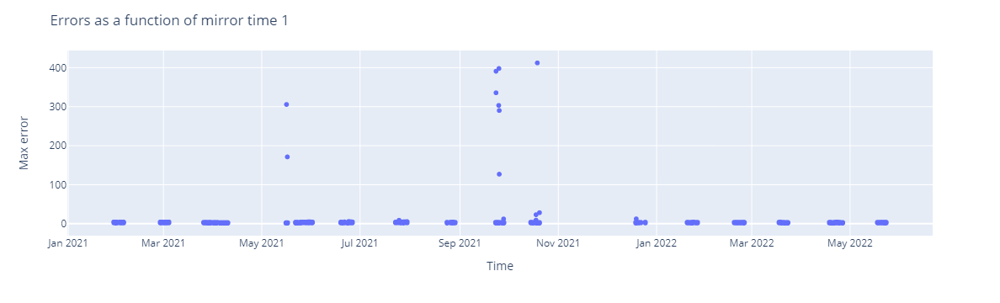

In [69]:
import plotly.express as px

# Crear la figura interactiva
fig = px.scatter(datos_con_tiempos, x='time', y='max')

# Personalizar la figura
fig.update_layout(
    title="Errors as a function of mirror time 1",
    xaxis_title="Time",
    yaxis_title="Max error"
)

# Mostrar la figura interactiva
fig.show()

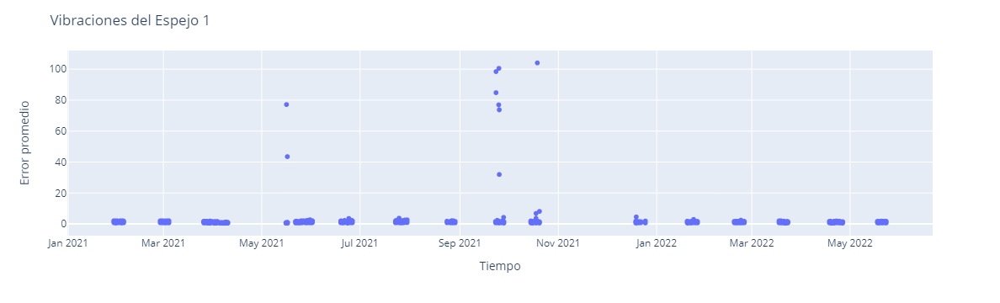

In [62]:
# Crear la figura interactiva
fig = px.scatter(datos_con_tiempos, x='time', y='promedio')

# fig.add_hline(y=1.2)

# Personalizar la figura
fig.update_layout(
    title="Vibraciones del Espejo 1",
    xaxis_title="Tiempo",
    yaxis_title="Error promedio"
)



# Mostrar la figura interactiva
fig.show()

In [63]:

# Convertir los datos a un objeto DataFrame de Pandas
df = pd.DataFrame(time, columns=['fecha'])

# Convertir la columna 'fecha' al tipo datetime
df['fecha'] = pd.to_datetime(df['fecha'])

# Filtrar los datos entre enero y febrero
filtro_normal = (df['fecha'].dt.month >= 1) & (df['fecha'].dt.month <= 2).values
filtro_anomalia = (df['fecha'].dt.month == 3) & (df['fecha'].dt.day >= 30) | (df['fecha'].dt.month == 4) & (df['fecha'].dt.day <= 11)



In [64]:
import seaborn as sns
parameters = {'axes.labelsize': 16,
                'axes.titlesize': 25,
                "xtick.labelsize": 12,
                "ytick.labelsize": 12}

plt.rcParams.update(parameters)

sns.set_style("darkgrid")
freq = freq.astype(float)

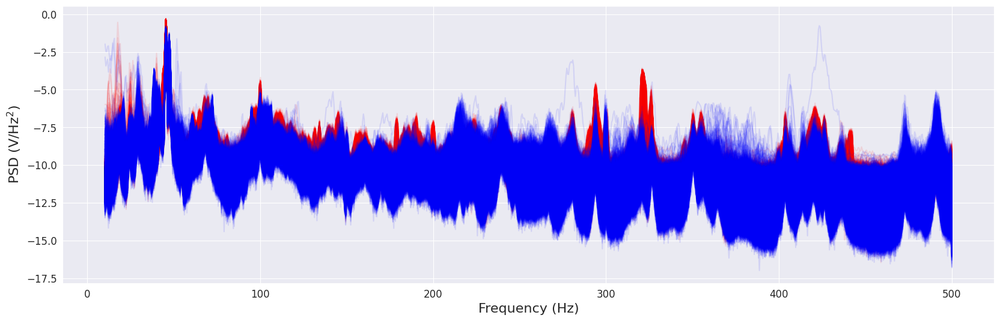

In [65]:

plt.figure(figsize=(20,6)) 

data_sensor_5_normal = data_sensor_5.numpy()[filtro_anomalia]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="red")

data_sensor_5_normal = data_sensor_5.numpy()[filtro_normal]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="blue")

plt.ylabel(r"$\mathrm{PSD\ (V/Hz^2)}$") 
plt.xlabel("Frequency (Hz)")
plt.show()

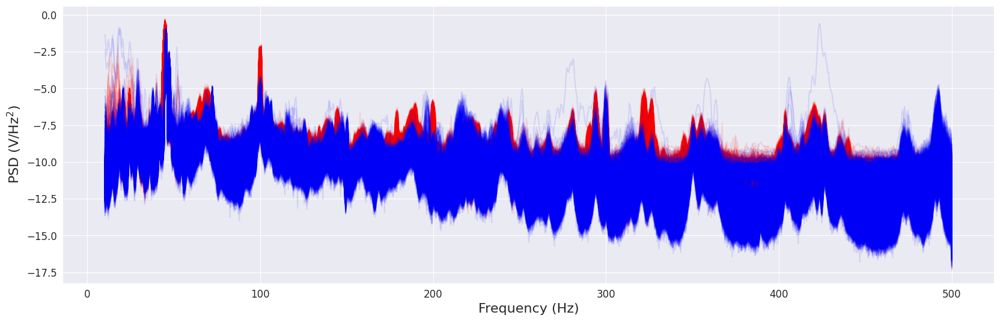

In [66]:
plt.figure(figsize=(20,6)) 

data_sensor_5_normal = data_sensor_6.numpy()[filtro_anomalia]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="red")

data_sensor_5_normal = data_sensor_6.numpy()[filtro_normal]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="blue")




    
plt.ylabel(r"$\mathrm{PSD\ (V/Hz^2)}$") 
plt.xlabel("Frequency (Hz)")
plt.show()

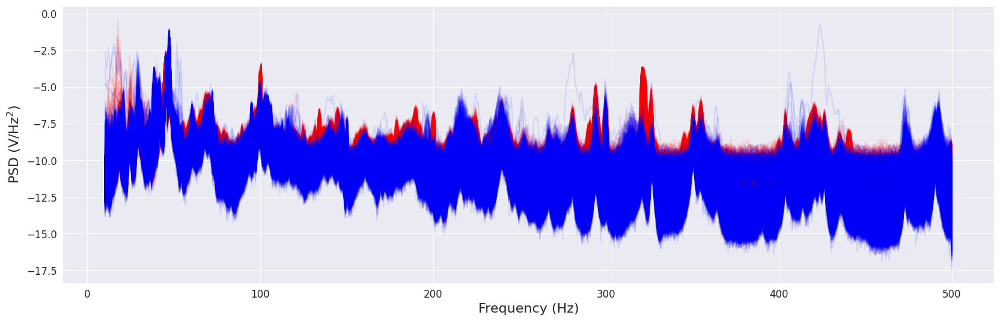

In [67]:
plt.figure(figsize=(20,6)) 

data_sensor_5_normal = data_sensor_7.numpy()[filtro_anomalia]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="red")

data_sensor_5_normal = data_sensor_7.numpy()[filtro_normal]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="blue")


    
plt.ylabel(r"$\mathrm{PSD\ (V/Hz^2)}$") 
plt.xlabel("Frequency (Hz)")
plt.show()

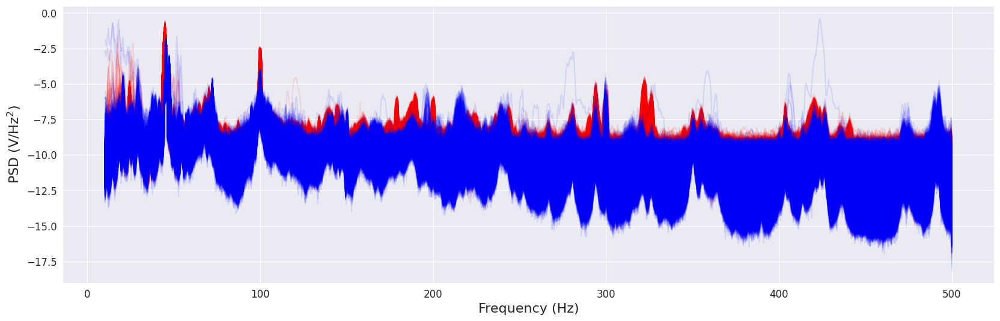

In [68]:
plt.figure(figsize=(20,6)) 

data_sensor_5_normal = data_sensor_8.numpy()[filtro_anomalia]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="red")
    
data_sensor_5_normal = data_sensor_8.numpy()[filtro_normal]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="blue")


    
plt.ylabel(r"$\mathrm{PSD\ (V/Hz^2)}$") 
plt.xlabel("Frequency (Hz)")
plt.show()

## Mirror 2: Sensor 1 and 2

In [31]:
data_sensor_1 = torch.Tensor(np.log(datasensor("sensor_1").dropna().values)).float()
data_sensor_2 = torch.Tensor(np.log(datasensor("sensor_2").dropna().values)).float()

time = datasensor("sensor_1").dropna().index.values

freq = datasensor("sensor_1").columns.astype(float)

In [32]:
# Ruta del archivo donde se guardó el model
ruta_actual = "/home/azureuser/cloudfiles/code/Users/jordanperez/apply"

# Cargar el modelo
model_sensor_1 = torch.load(ruta_actual+"/sensor_1_VAE")
model_sensor_2 = torch.load(ruta_actual+"/sensor_2_VAE")

In [33]:
model_sensor_1.eval()
model_sensor_2.eval()


with torch.no_grad():
    datos_reconstruidos_1 = model_sensor_1(data_sensor_1)[0]
    datos_reconstruidos_2 = model_sensor_2(data_sensor_2)[0]


# Calcular la pérdida de reconstruccón (error)
error_1 = torch.mean((data_sensor_1 - datos_reconstruidos_1)**2, axis=1).numpy()
error_2 = torch.mean((data_sensor_2 - datos_reconstruidos_2)**2, axis=1).numpy()




datos_con_tiempos= pd.DataFrame({"time": time, "error_1": error_1, 
                                                "error_2": error_2,
                                                })

datos_con_tiempos['max'] = datos_con_tiempos[['error_1', 'error_2']].max(axis=1)
datos_con_tiempos['desviacion'] = datos_con_tiempos[['error_1', 'error_2']].std(axis=1)
datos_con_tiempos['promedio'] = datos_con_tiempos[['error_1', 'error_2']].mean(axis=1)


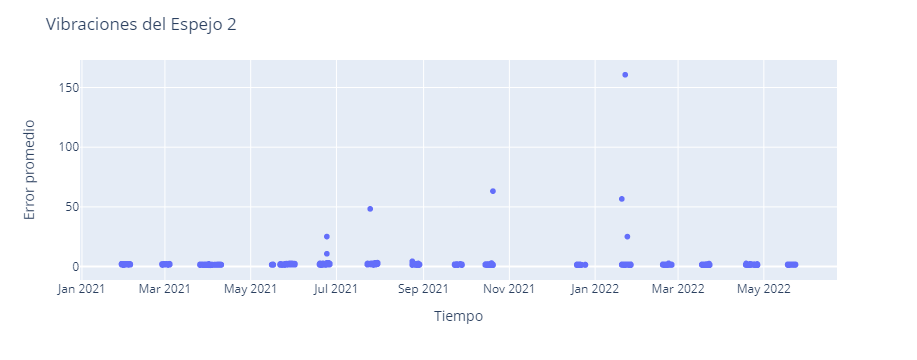

In [34]:
# Crear la figura interactiva
fig = px.scatter(datos_con_tiempos, x='time', y='promedio')

# fig.add_hline(y=1.2)

# Personalizar la figura
fig.update_layout(
    title="Vibraciones del Espejo 2",
    xaxis_title="Tiempo",
    yaxis_title="Error promedio"
)



# Mostrar la figura interactiva
fig.show()

In [35]:
import pandas as pd

# Convertir los datos a un objeto DataFrame de Pandas
df = pd.DataFrame(time, columns=['fecha'])

# Convertir la columna 'fecha' al tipo datetime
df['fecha'] = pd.to_datetime(df['fecha'])

# Filtrar las anomalías (mayo de 2022 con valores mayores a 1)
filtro_anomalia = (df['fecha'].dt.year >= 2022) & (df['fecha'].dt.month == 5) & (df['fecha'].dt.day > 1) 

# Filtrar los datos normales (febrero 20 del 2021 a marzo 5 del 2021)
filtro_normal = (df['fecha'].dt.year == 2021) & (df['fecha'].dt.month == 2) & (df['fecha'].dt.day >= 20) | (df['fecha'].dt.year == 2021) & (df['fecha'].dt.month == 3) & (df['fecha'].dt.day <= 5)



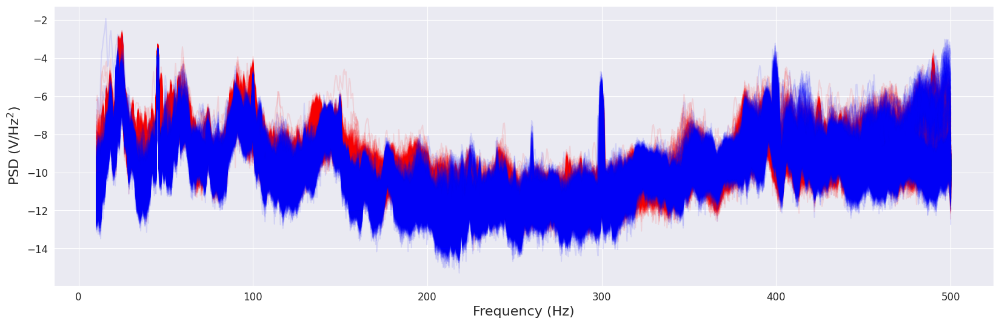

In [36]:
plt.figure(figsize=(20,6)) 

data_sensor_5_normal = data_sensor_1.numpy()[filtro_anomalia]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="red")

data_sensor_5_normal = data_sensor_1.numpy()[filtro_normal]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="blue")




    
plt.ylabel(r"$\mathrm{PSD\ (V/Hz^2)}$") 
plt.xlabel("Frequency (Hz)")
plt.show()

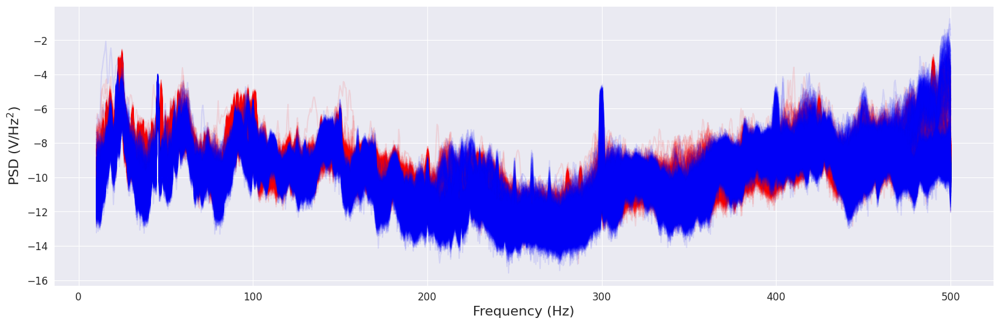

In [37]:
plt.figure(figsize=(20,6)) 

data_sensor_5_normal = data_sensor_2.numpy()[filtro_anomalia]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="red")

data_sensor_5_normal = data_sensor_2.numpy()[filtro_normal]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="blue")

plt.ylabel(r"$\mathrm{PSD\ (V/Hz^2)}$") 
plt.xlabel("Frequency (Hz)")
plt.show()

# Sensor 3

In [38]:
data_sensor_3 = torch.Tensor(np.log(datasensor("sensor_3").dropna().values)).float()

time = datasensor("sensor_3").dropna().index.values

freq = datasensor("sensor_3").columns.astype(float)

In [39]:
# Ruta del archivo donde se guardó el model
ruta_actual = "/home/azureuser/cloudfiles/code/Users/jordanperez/apply"

# Cargar el modelo
model_sensor_3 = torch.load(ruta_actual+"/sensor_3_VAE")

In [40]:
model_sensor_3.eval()


with torch.no_grad():
    datos_reconstruidos_3 = model_sensor_3(data_sensor_3)[0]


# Calcular la pérdida de reconstruccón (error)
error_3 = torch.mean((data_sensor_3 - datos_reconstruidos_3)**2, axis=1).numpy()




datos_con_tiempos= pd.DataFrame({"time": time, "error_3": error_3, 
                                                })

datos_con_tiempos['max'] = datos_con_tiempos[['error_3']].max(axis=1)
datos_con_tiempos['desviacion'] = datos_con_tiempos[['error_3']].std(axis=1)
datos_con_tiempos['promedio'] = datos_con_tiempos[['error_3']].mean(axis=1)

In [41]:
datos_con_tiempos

,time,error_3,max,desviacion,promedio
0,2021-01-29 04:26:00,0.659310,0.659310,NaN,0.659310
1,2021-01-29 04:29:00,0.521715,0.521715,NaN,0.521715
2,2021-01-29 04:30:00,0.530436,0.530436,NaN,0.530436
3,2021-01-29 04:31:00,0.518543,0.518543,NaN,0.518543
4,2021-01-29 04:32:00,0.529550,0.529550,NaN,0.529550
...,...,...,...,...,...
47262,2022-05-23 10:28:00,0.311995,0.311995,NaN,0.311995
47263,2022-05-23 10:29:00,0.286646,0.286646,NaN,0.286646
47264,2022-05-23 10:30:00,0.282469,0.282469,NaN,0.282469
47265,2022-05-23 10:31:00,0.343538,0.343538,NaN,0.343538


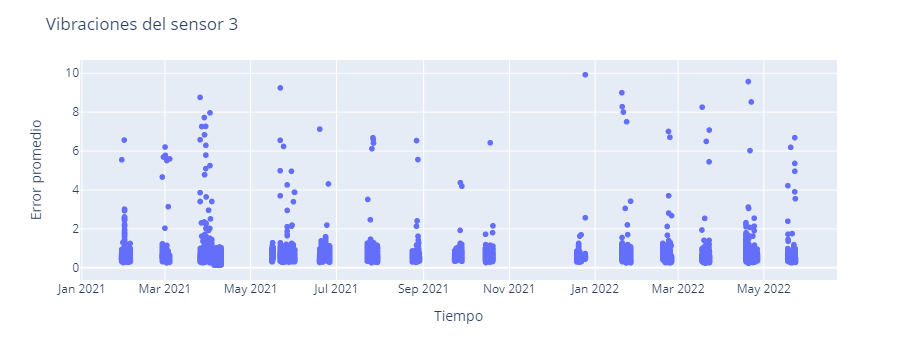

In [42]:
# Crear la figura interactiva
fig = px.scatter(datos_con_tiempos, x='time', y='promedio')

# fig.add_hline(y=1.2)

# Personalizar la figura
fig.update_layout(
    title="Vibraciones del sensor 3",
    xaxis_title="Tiempo",
    yaxis_title="Error promedio"
)



# Mostrar la figura interactiva
fig.show()

# Sensor 4

In [43]:
data_sensor_4 = torch.Tensor(np.log(datasensor("sensor_4").dropna().values)).float()

time = datasensor("sensor_4").dropna().index.values

freq = datasensor("sensor_4").columns.astype(float)

In [44]:
# Ruta del archivo donde se guardó el model
ruta_actual = "/home/azureuser/cloudfiles/code/Users/jordanperez/apply"

# Cargar el modelo
model_sensor_4 = torch.load(ruta_actual+"/sensor_4_VAE")

In [45]:
model_sensor_4.eval()


with torch.no_grad():
    datos_reconstruidos_4 = model_sensor_4(data_sensor_4)[0]


# Calcular la pérdida de reconstruccón (error)
error_4 = torch.mean((data_sensor_4 - datos_reconstruidos_4)**2, axis=1).numpy()




datos_con_tiempos= pd.DataFrame({"time": time, "error_4": error_4, 
                                                })

datos_con_tiempos['max'] = datos_con_tiempos[['error_4']].max(axis=1)
datos_con_tiempos['desviacion'] = datos_con_tiempos[['error_4']].std(axis=1)
datos_con_tiempos['promedio'] = datos_con_tiempos[['error_4']].mean(axis=1)

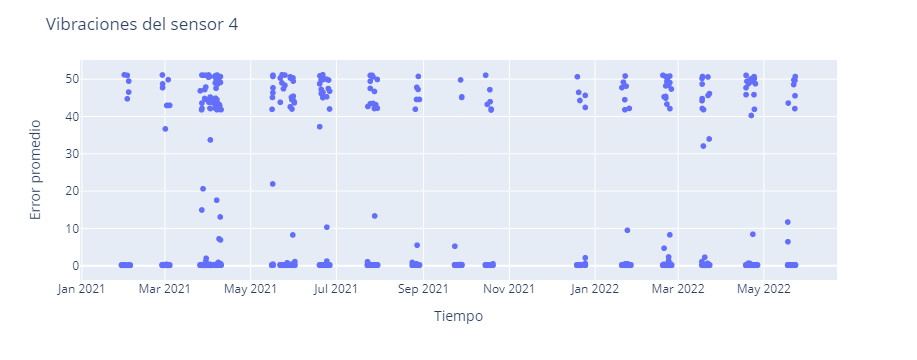

In [46]:
# Crear la figura interactiva
fig = px.scatter(datos_con_tiempos, x='time', y='promedio')

# fig.add_hline(y=1.2)

# Personalizar la figura
fig.update_layout(
    title="Vibraciones del sensor 4",
    xaxis_title="Tiempo",
    yaxis_title="Error promedio"
)



# Mostrar la figura interactiva
fig.show()

# Sensores M

In [47]:
data_m1 = torch.Tensor(np.log(datasensor("m1").dropna().values)).float()
data_m1_3 = torch.Tensor(np.log(datasensor("m1-3").dropna().values)).float()
data_m2 = torch.Tensor(np.log(datasensor("m2").dropna().values)).float()
data_m3 = torch.Tensor(np.log(datasensor("m3").dropna().values)).float()

time = datasensor("m3").dropna().index.values

freq = datasensor("m3").columns.astype(float)

In [48]:
# Ruta del archivo donde se guardó el model
ruta_actual = "/home/azureuser/cloudfiles/code/Users/jordanperez/apply"

# Cargar el modelo
model_m1 = torch.load(ruta_actual+"/m1_VAE")
model_m1_3 = torch.load(ruta_actual+"/m1-3_VAE")
model_m2 = torch.load(ruta_actual+"/m2_VAE")
model_m3 = torch.load(ruta_actual+"/m3_VAE")


In [49]:
model_m1.eval()
model_m1_3.eval()
model_m2.eval()
model_m3.eval()



with torch.no_grad():
    datos_reconstruidos_m1 = model_m1(data_m1)[0]
    datos_reconstruidos_m1_3 = model_m1_3(data_m1_3)[0]
    datos_reconstruidos_m2 = model_m2(data_m2)[0]
    datos_reconstruidos_m3 = model_m3(data_m3)[0]



# Calcular la pérdida de reconstruccón (error)
error_m1 = torch.mean((data_m1 - datos_reconstruidos_m1)**2, axis=1).numpy()
error_m1_3 = torch.mean((data_m1_3 - datos_reconstruidos_m1_3)**2, axis=1).numpy()
error_m2 = torch.mean((data_m2 - datos_reconstruidos_m2)**2, axis=1).numpy()
error_m3 = torch.mean((data_m3 - datos_reconstruidos_m3)**2, axis=1).numpy()





datos_con_tiempos= pd.DataFrame({"time": time, "error_m1": error_m1, 
                                                "error_m1_3": error_m1_3, 
                                                "error_m2": error_m2, 
                                                "error_m3": error_m3, 

                                                })

datos_con_tiempos['max'] = datos_con_tiempos[['error_m1', "error_m1_3", "error_m2","error_m3" ]].max(axis=1)
datos_con_tiempos['desviacion'] = datos_con_tiempos[['error_m1', "error_m1_3", "error_m2","error_m3" ]].std(axis=1)
datos_con_tiempos['promedio'] = datos_con_tiempos[['error_m1', "error_m1_3", "error_m2","error_m3" ]].mean(axis=1)

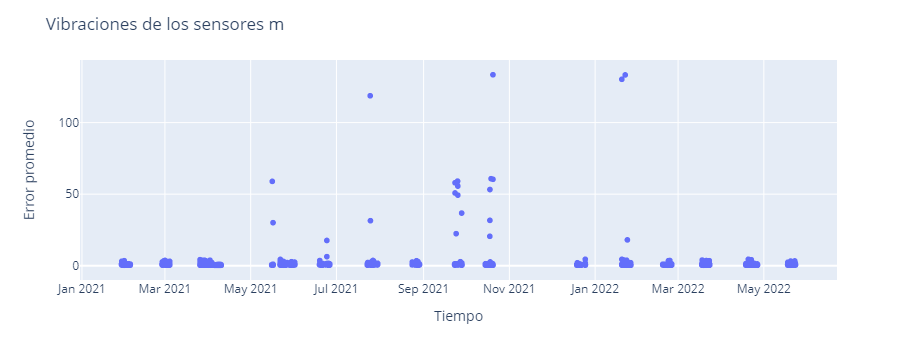

In [50]:
# Crear la figura interactiva
fig = px.scatter(datos_con_tiempos, x='time', y='promedio')

# fig.add_hline(y=1.2)

# Personalizar la figura
fig.update_layout(
    title="Vibraciones de los sensores m",
    xaxis_title="Tiempo",
    yaxis_title="Error promedio"
)



# Mostrar la figura interactiva
fig.show()